In [79]:
import mdtraj as md
import numpy as np
import pandas as pd
import plotly.express as px

In [59]:
cd desktop\internship\aryan_internship

[WinError 3] The system cannot find the path specified: 'desktop\\internship\\aryan_internship'
C:\Users\Aryan\desktop\internship\aryan_internship


In [60]:
new_ALA_wat=md.load('ALA_wat_traj.dcd',top='ALA_wat_trial.pdb',stride=1000) #Choosing every 1000-th frame 

In [62]:
H_BONDS=md.baker_hubbard(new_ALA_wat,exclude_water=False,distance_cutoff=0.35,angle_cutoff=135,freq=0.2)

In [64]:
for hbond in H_BONDS:
    print(str(new_ALA_wat.top.atom(hbond[0]))+"--"+str(new_ALA_wat.top.atom(hbond[1]))+"-"*10+str(new_ALA_wat.top.atom(hbond[2])))

ALA1-N--ALA1-H----------HOH1-O
ALA1-N--ALA1-H----------HOH4-O
ALA1-N--ALA1-H2----------HOH4-O
ALA1-N--ALA1-H3----------HOH1-O
ALA1-N--ALA1-H3----------HOH1-O
LEU2-N--LEU2-H----------HOH1-O
ALA3-N--ALA3-H----------HOH5-O
HOH4-O--HOH4-H1----------HOH1-O
HOH4-O--HOH4-H2----------HOH5-O
HOH4-O--HOH4-H2----------HOH1-O
HOH5-O--HOH5-H1----------HOH5-O
HOH5-O--HOH5-H1----------HOH8-O
HOH5-O--HOH5-H2----------HOH1-O
HOH5-O--HOH5-H2----------HOH1-O
HOH6-O--HOH6-H1----------HOH5-O
HOH6-O--HOH6-H1----------HOH1-O
HOH6-O--HOH6-H2----------HOH9-O
HOH6-O--HOH6-H2----------HOH1-O
HOH7-O--HOH7-H1----------HOH7-O
HOH7-O--HOH7-H1----------HOH1-O
HOH7-O--HOH7-H1----------HOH1-O
HOH7-O--HOH7-H2----------HOH5-O
HOH7-O--HOH7-H2----------HOH1-O
HOH7-O--HOH7-H2----------HOH1-O
HOH8-O--HOH8-H1----------HOH2-O
HOH8-O--HOH8-H2----------HOH1-O
HOH9-O--HOH9-H1----------HOH8-O
HOH9-O--HOH9-H2----------HOH5-O
HOH1-O--HOH1-H1----------HOH4-O
HOH1-O--HOH1-H1----------HOH1-O
HOH1-O--HOH1-H1----------HOH1-O
HOH1-O--HOH1

In [66]:
non_H2O_hbonds=[]
for hbond in H_BONDS:
    if(not(new_ALA_wat.top.atom(hbond[0]).residue.name=='HOH' and new_ALA_wat.top.atom(hbond[2]).residue.name=='HOH')):
        non_H2O_hbonds.append(hbond)
        print(str(new_ALA_wat.top.atom(hbond[0]))+"--"+str(new_ALA_wat.top.atom(hbond[1]))+"-"*10+str(new_ALA_wat.top.atom(hbond[2])))
        
    

ALA1-N--ALA1-H----------HOH1-O
ALA1-N--ALA1-H----------HOH4-O
ALA1-N--ALA1-H2----------HOH4-O
ALA1-N--ALA1-H3----------HOH1-O
ALA1-N--ALA1-H3----------HOH1-O
LEU2-N--LEU2-H----------HOH1-O
ALA3-N--ALA3-H----------HOH5-O
HOH3-O--HOH3-H1----------ALA1-O
HOH3-O--HOH3-H1----------LEU2-O
HOH3-O--HOH3-H1----------ALA3-N
HOH5-O--HOH5-H2----------ALA3-O
HOH5-O--HOH5-H2----------ALA3-OXT
HOH6-O--HOH6-H2----------ALA3-O
HOH6-O--HOH6-H2----------ALA3-OXT
HOH7-O--HOH7-H2----------ALA3-O
HOH7-O--HOH7-H2----------ALA3-OXT
HOH8-O--HOH8-H1----------ALA3-O
HOH1-O--HOH1-H2----------ALA3-OXT


In [70]:
info_table,bonds=new_ALA_wat.top.to_dataframe()

In [71]:
info_table

,serial,name,element,resSeq,resName,chainID,segmentID
0,1,N,N,1,ALA,0,
1,2,H,H,1,ALA,0,
2,3,H2,H,1,ALA,0,
3,4,H3,H,1,ALA,0,
4,5,CA,C,1,ALA,0,
...,...,...,...,...,...,...,...
634,635,H1,H,2,HOH,1,
635,636,H2,H,2,HOH,1,
636,637,O,O,2,HOH,1,
637,638,H1,H,2,HOH,1,


In [76]:
f_HBONDS=md.baker_hubbard(new_ALA_wat[0],exclude_water=False,distance_cutoff=0.35,angle_cutoff=135)

In [77]:
f_non_H2O_hbonds=[]
for hbond in f_HBONDS:
    if(not(new_ALA_wat.top.atom(hbond[0]).residue.name=='HOH' and new_ALA_wat.top.atom(hbond[2]).residue.name=='HOH')):
        non_H2O_hbonds.append(hbond)
        print(str(new_ALA_wat.top.atom(hbond[0]))+"--"+str(new_ALA_wat.top.atom(hbond[1]))+"-"*10+str(new_ALA_wat.top.atom(hbond[2])))
        

ALA1-N--ALA1-H----------HOH4-O
ALA1-N--ALA1-H3----------HOH1-O
LEU2-N--LEU2-H----------HOH1-O
ALA3-N--ALA3-H----------HOH1-O
HOH3-O--HOH3-H1----------LEU2-O
HOH5-O--HOH5-H2----------ALA3-O
HOH5-O--HOH5-H2----------ALA3-OXT
HOH8-O--HOH8-H1----------ALA3-O


In [122]:
polar_groups=['O','N','S','F']   #The polar groups present in this molecule

polar_idx=[atom.index for atom in new_ALA_wat.top.atoms if(atom.element.symbol in polar_groups and atom.residue.name!="HOH")] #indices of the polar group


polar_idx


        
    



[0, 11, 12, 30, 31, 40, 41]

In [81]:
polar_count=[0 for idx in polar_idx]      #For evauluating  the total number of hydrogen bonds formed 

                                          #inefficient way !!!!(Smarter way- Just use .flatten() function )
for frame in md.iterload('ALA_wat_traj.dcd',top='ALA_wat_trial.pdb',chunk=1):
    
    frame_H_BONDS=md.baker_hubbard(frame,exclude_water=False,distance_cutoff=0.35,angle_cutoff=135)
    
    frame_non_H2O_hbonds=[hbond for hbond in  frame_H_BONDS if(new_ALA_wat.top.atom(hbond[0]).residue.name!='HOH' or  new_ALA_wat.top.atom(hbond[2]).residue.name!='HOH')]
    
    
    for bond in frame_non_H2O_hbonds:
        match=0
        for i,idx in enumerate(polar_idx):   # Loop invariant match<=2
            if(match==2):
                break
                
            if(idx in bond):
                polar_counts[i]=polar_counts[i]+1
                match=match+1
            
        
        

In [99]:
polar_counts

[341140, 44315, 124465, 73767, 147052, 299082, 274043]

In [94]:
binary_polar_counts=[0 for idx in polar_idx]   #This stores the number of frames in which hydrogen bond is formed 
                                               #inefficient way!!!-(Smarter way -Just use .flatten() function !!!!)
frame_count=0

check_skip=[False for idx in polar_idx]   #check for skipping the inner loop

for frame in md.iterload('ALA_wat_traj.dcd',top='ALA_wat_trial.pdb',chunk=1):
    this_frame=[True for i in polar_idx]    #At the beginning there are no bonds detected for any of the groups
    
    frame_count=frame_count+1              #Tracking the frame_count 
    
    frame_H_BONDS=md.baker_hubbard(frame,exclude_water=False,distance_cutoff=0.35,angle_cutoff=135)
    
    frame_non_H2O_hbonds=[hbond for hbond in  frame_H_BONDS if(new_ALA_wat.top.atom(hbond[0]).residue.name!='HOH' or  new_ALA_wat.top.atom(hbond[2]).residue.name!='HOH')]
    
    
    for bond in frame_non_H2O_hbonds :
        
        if(this_frame==check_skip):    #Condition for moving on to the next frame 
            break
            
        match=0                      #Each bond can contain only two polar groups 
        
        for i,idx in enumerate(polar_idx): #Loop invariant-match<=2
            if(match==2):               #Exit condition for this loop 
                break                 
        
            
                
            if(idx in bond):
                match=match+1   
                
                if(this_frame[i]==True):
                    binary_polar_counts[i]=binary_polar_counts[i]+1
                    this_frame[i]=False
                    
                
                
                
                    
                
                

In [95]:
binary_polar_counts

[102441, 42728, 101674, 62731, 101187, 102389, 101418]

In [86]:
frame_count

102441

In [108]:
x_axis_data=[str(new_ALA_wat.top.atom(idx)) for idx in polar_idx]
px.bar(data_frame=None,x=x_axis_data,y=np.array(polar_counts)/frame_count,title="Average Number of H-Bonds per  frame")

In [109]:
px.bar(data_frame=None,x=x_axis_data,y=np.array(binary_polar_counts)/frame_count,title="Frequency of H-Bond formation")

In [151]:
x=np.array([1,2,3,4,4])
np.count_nonzero(x==4)

2

In [119]:
fraction_of_frames =np.array(binary_polar_counts)/frame_count
polar_idx=np.array(polar_idx)
track_group=polar_idx[fraction_of_frames!=1]

In [124]:
binary_group_track=[[] for t in track_group]
for frame in md.iterload('ALA_wat_traj.dcd',top='ALA_wat_trial.pdb',chunk=1):
    
    frame_H_BONDS=(md.baker_hubbard(frame,exclude_water=False,distance_cutoff=0.35,angle_cutoff=135)).flatten()
    for i,idx in enumerate(track_group):
        if(idx in frame_H_BONDS):
            binary_group_track[i].append(1)
        else:
            binary_group_track[i].append(0)
            
        
        

In [134]:

binary_group_track=np.array(binary_group_track)
binary_group_track.shape
np.arange(1,12)

array([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11])

In [140]:

px.line(data_frame=None,x=np.arange(1,frame_count+1),y=binary_group_track[0],title=str(new_ALA_wat.top.atom(track_group[0])))



In [141]:
px.line(data_frame=None,x=np.arange(1,frame_count+1),y=binary_group_track[1],title=str(new_ALA_wat.top.atom(track_group[1])))

In [142]:
px.line(data_frame=None,x=np.arange(1,frame_count+1),y=binary_group_track[2],title=str(new_ALA_wat.top.atom(track_group[2])))

In [143]:
px.line(data_frame=None,x=np.arange(1,frame_count+1),y=binary_group_track[3],title=str(new_ALA_wat.top.atom(track_group[3])))

In [144]:
px.line(data_frame=None,x=np.arange(1,frame_count+1),y=binary_group_track[4],title=str(new_ALA_wat.top.atom(track_group[4])))

In [145]:
px.line(data_frame=None,x=np.arange(1,frame_count+1),y=binary_group_track[5],title=str(new_ALA_wat.top.atom(track_group[5])))

In [153]:
num_H_bonds=[[] for idx in polar_idx]

for frame in md.iterload('ALA_wat_traj.dcd',top='ALA_wat_trial.pdb',chunk=1):
    
    frame_H_BONDS=(md.baker_hubbard(frame,exclude_water=False,distance_cutoff=0.35,angle_cutoff=135)).flatten()
    for i,idx in enumerate(polar_idx):
        num=np.count_nonzero(frame_H_BONDS==idx)
        num_H_bonds[i].append(num)
        


In [160]:
import matplotlib.pyplot as plt

(array([0.        , 0.00234316, 0.08656005, 0.56801008, 0.27193291,
        0.07115381]),
 array([0, 1, 2, 3, 4, 5, 6]),
 <a list of 1 Patch objects>)

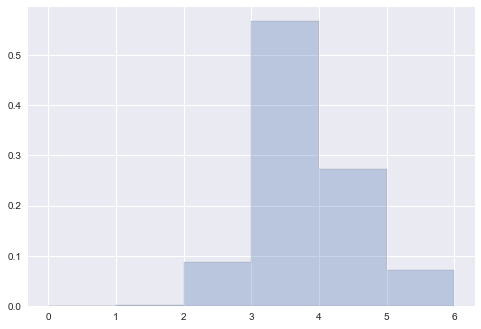

In [188]:
plt.style.use('seaborn')
plt.hist(num_H_bonds[0],histtype='stepfilled',density=True,edgecolor='black',alpha=0.3,bins=np.arange(0,7,1)
        )

(array([5.82901377e-01, 4.01645825e-01, 1.54235121e-02, 2.92851495e-05,
        0.00000000e+00, 0.00000000e+00]),
 array([0, 1, 2, 3, 4, 5, 6]),
 <a list of 1 Patch objects>)

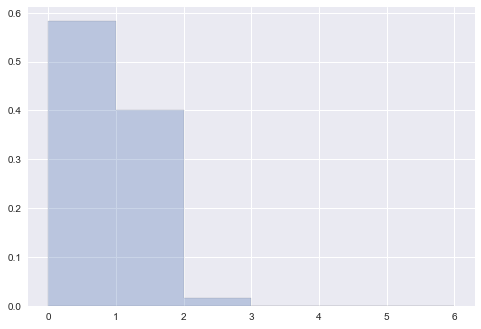

In [189]:
plt.hist(num_H_bonds[1],histtype='stepfilled',density=True,edgecolor='black',alpha=0.3,bins=np.arange(0,7,1)
        )

(array([0.00748724, 0.78062495, 0.20130612, 0.0105817 , 0.        ,
        0.        ]),
 array([0, 1, 2, 3, 4, 5, 6]),
 <a list of 1 Patch objects>)

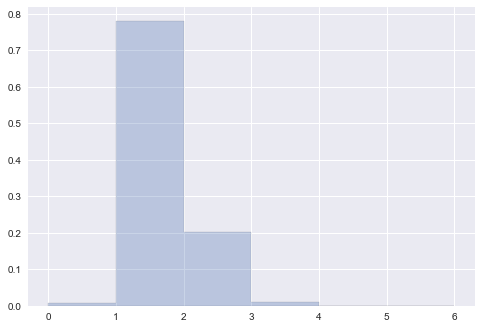

In [190]:
plt.hist(num_H_bonds[2],histtype='stepfilled',density=True,edgecolor='black',alpha=0.3,bins=np.arange(0,7,1)
        )

(array([0.38763776, 0.50925899, 0.09848596, 0.00461729, 0.        ,
        0.        ]),
 array([0, 1, 2, 3, 4, 5, 6]),
 <a list of 1 Patch objects>)

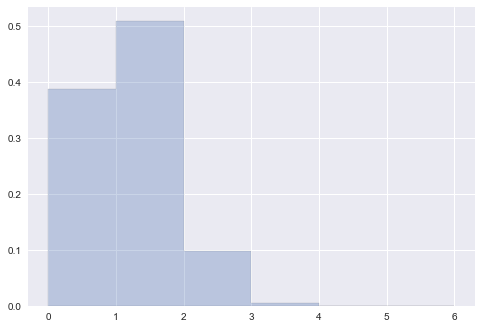

In [191]:
plt.hist(num_H_bonds[3],histtype='stepfilled',density=True,edgecolor='black',alpha=0.3,bins=np.arange(0,7,1)
        )

(array([0.01224119, 0.58793842, 0.35377437, 0.04420105, 0.00184496,
        0.        ]),
 array([0, 1, 2, 3, 4, 5, 6]),
 <a list of 1 Patch objects>)

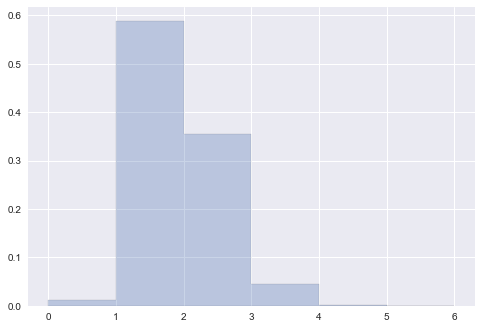

In [192]:
plt.hist(num_H_bonds[4],histtype='stepfilled',density=True,edgecolor='black',alpha=0.3,bins=np.arange(0,7,1)
        )

(array([5.07609258e-04, 1.16945364e-02, 2.63800627e-01, 5.30520007e-01,
        1.79068927e-01, 1.44082936e-02]),
 array([0, 1, 2, 3, 4, 5, 6]),
 <a list of 1 Patch objects>)

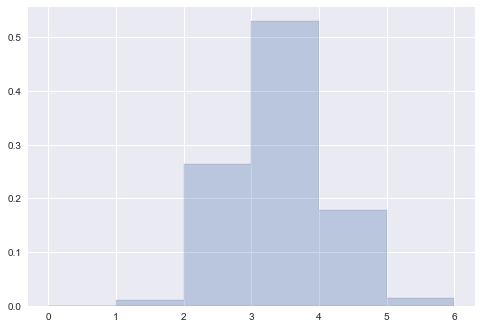

In [193]:
plt.hist(num_H_bonds[5],histtype='stepfilled',density=True,edgecolor='black',alpha=0.3,bins=np.arange(0,7,1)
        )

In [194]:
Distances=[[] for idx in polar_idx]
Angles =[[] for idx in polar_idx ]
for frame in md.iterload('ALA_wat_traj.dcd',top='ALA_wat_trial.pdb',chunk=1):
    
    frame_H_BONDS=md.baker_hubbard(frame,exclude_water=False,distance_cutoff=0.35,angle_cutoff=135)
    
    frame_non_H2O_hbonds=[hbond for hbond in  frame_H_BONDS if(new_ALA_wat.top.atom(hbond[0]).residue.name!='HOH' or  new_ALA_wat.top.atom(hbond[2]).residue.name!='HOH')]
    
    for bond in frame_non_H2O_hbonds:
        for i,idx in enumerate(polar_idx):
            if(idx in bond):
                Distances[i].append(md.compute_distances(frame,[[bond[1],bond[2]]]))
                Angles[i].append(md.compute_angles(frame,[bond]))
        
    
    
    
    
    
    
    
    
    
    
    
    
    
    
    

In [208]:
for i,distance in enumerate(Distances):
    Distances[i]=np.array(distance).flatten()

In [211]:
for i,angle in enumerate(Angles):
    Angles[i]=np.array(angle).flatten()

Text(0.5, 1.0, 'ALA1-N')

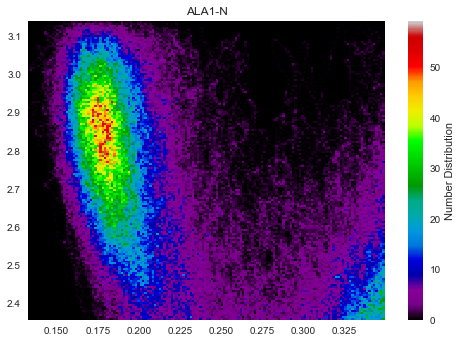

In [242]:
plt.hist2d(Distances[0],Angles[0],bins=150,cmap="nipy_spectral",density=True)
color_bar=plt.colorbar()
color_bar.set_label("Number Distribution")
plt.title(str(new_ALA_wat.top.atom(polar_idx[0])))

Text(0.5, 1.0, 'ALA1-O')

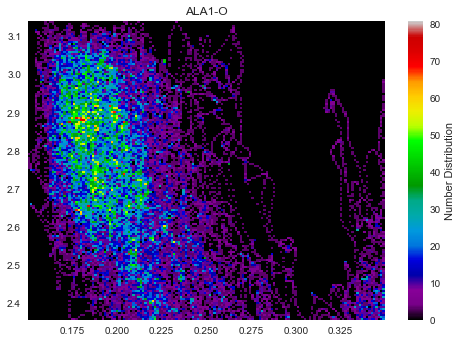

In [241]:
plt.hist2d(Distances[1],Angles[1],bins=150,cmap="nipy_spectral",density=True)
color_bar=plt.colorbar()
color_bar.set_label("Number Distribution")
plt.title(str(new_ALA_wat.top.atom(polar_idx[1])))

Text(0.5, 1.0, 'LEU2-N')

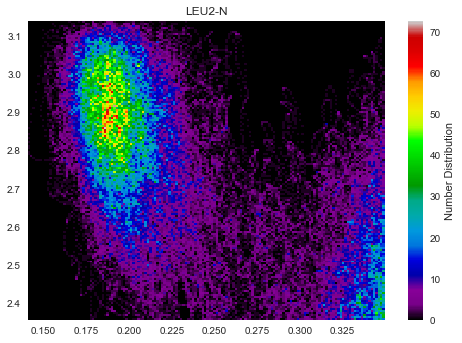

In [240]:
plt.hist2d(Distances[2],Angles[2],bins=150,cmap="nipy_spectral",density=True)
color_bar=plt.colorbar()
color_bar.set_label("Number Distribution")
plt.title(str(new_ALA_wat.top.atom(polar_idx[2])))

Text(0.5, 1.0, 'LEU2-O')

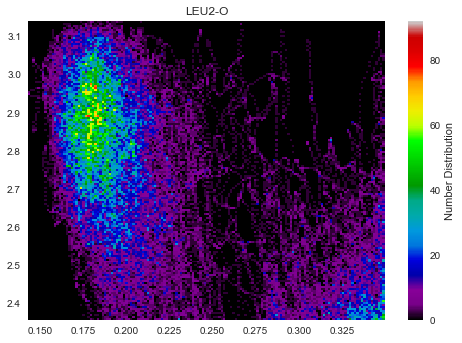

In [239]:
plt.hist2d(Distances[3],Angles[3],bins=150,cmap="nipy_spectral",density=True)
color_bar=plt.colorbar()
color_bar.set_label("Number Distribution")
plt.title(str(new_ALA_wat.top.atom(polar_idx[3])))

Text(0.5, 1.0, 'ALA3-N')

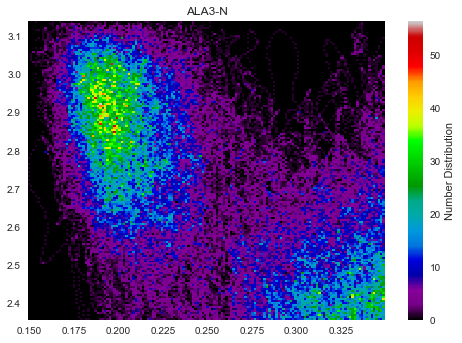

In [238]:
plt.hist2d(Distances[4],Angles[4],bins=150,cmap="nipy_spectral",density=True)
color_bar=plt.colorbar()
color_bar.set_label("Number Distribution")
plt.title(str(new_ALA_wat.top.atom(polar_idx[4])))

Text(0.5, 1.0, 'ALA3-O')

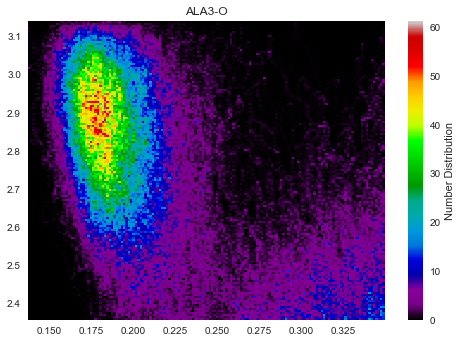

In [236]:
plt.hist2d(Distances[5],Angles[5],bins=150,cmap="nipy_spectral",density=True)
color_bar=plt.colorbar()
color_bar.set_label("Number Distribution")
plt.title(str(new_ALA_wat.top.atom(polar_idx[5])))

Text(0.5, 1.0, 'ALA3-OXT')

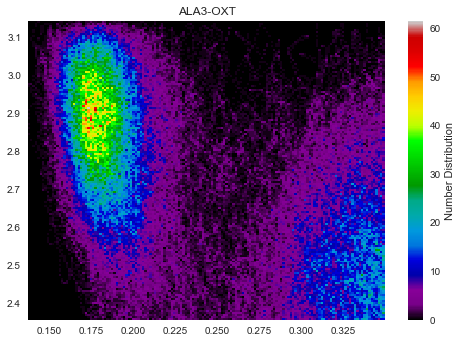

In [237]:
plt.hist2d(Distances[6],Angles[6],bins=150,cmap="nipy_spectral",density=True)
color_bar=plt.colorbar()
color_bar.set_label("Number Distribution")
plt.title(str(new_ALA_wat.top.atom(polar_idx[6])))